#  <font color='orange'>CUNEF</font>
# `Machine Learning`
# `Yelp Dataset`
# `02_EDA_Yelp`
## Authors:
### Jorge Plaza Yuste
### Álvaro Gómez Pérez

## Libraries

In [1]:
# Warnings
import warnings
warnings.filterwarnings('ignore')

# Basic
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import ast
from collections import Counter

# Statistic 
import math
from scipy.stats import chi2_contingency

# Maps
import folium as fl
from folium import Choropleth, Circle, Marker
from folium.plugins import MarkerCluster, HeatMap

#Graphs
import networkx as nx

## Functions

#### Data loading and saving

In [2]:
def load_data(files):
    """
    Load the data from parquet format.
    The output is a list of pandas dataframes.
    """     
    # Dataframe list:
    data = []
    
    # Iteration for loading each file:
    for i in range(0,len(files)): 

        # Store the dataframes
        reader = pd.read_parquet(files[i])

        data.append(reader)
        
    return data

def save_dfs_to_parquet(dataframes, filenames):
    """
    Save the model to parquet.
    The file path must end with '.pkl'.
    """
    for df, file in zip(dataframes, filenames):
        df.to_parquet(file)

#### Data treatment and Statistic

In [3]:
def words_counter(df, column, n_words):
    """
    Given a dataframe and a text column, returns a dataframe with the most common words.
    """       
    words = df[pd.notnull(df[column])][column].str.split().tolist()
    
    # Flatten the list of lists into a single list of words
    words = [word for sublist in words for word in sublist]
    
    # Remove the commas from the words
    words = [word.replace(',', '') for word in words]
    
    # Count the frequency of each word
    word_counts = Counter(words)
    
    # Get the 15 most common words
    most_common_words = word_counts.most_common(n_words)
    
    # Return the most common words
    return pd.DataFrame(most_common_words, columns=['word', 'count'])

def get_deviation_of_mean_perc(df, list_var_continuous, target, multiplier):
    """
    Devuelve el porcentaje de valores que exceden del intervalo de confianza
    :type series:
    :param multiplier:
    :return:
    """
    pd_final = pd.DataFrame()
    
    for i in list_var_continuous:
        
        series_mean = df[i].mean()
        series_std = df[i].std()
        std_amp = multiplier * series_std
        left = series_mean - std_amp
        right = series_mean + std_amp
        size_s = df[i].size
        
        perc_goods = df[i][(df[i] >= left) & (df[i] <= right)].size/size_s
        perc_excess = df[i][(df[i] < left) | (df[i] > right)].size/size_s
        
        if perc_excess>0:    
            pd_concat_percent = pd.DataFrame(df[target][(df[i] < left) | (df[i] > right)]\
                                            .value_counts(normalize=True).reset_index())
            pd_concat_percent.sort_values(by = 'index',inplace=True)
            pd_concat_percent = pd_concat_percent.T
            pd_concat_percent.columns = pd_concat_percent.iloc[0,:]
            pd_concat_percent = pd_concat_percent.drop('index',axis=0)
            pd_concat_percent['variable'] = i
            pd_concat_percent['sum_outlier_values'] = df[i][(df[i] < left) | (df[i] > right)].size
            pd_concat_percent['porcentaje_sum_null_values'] = perc_excess
            pd_final = pd.concat([pd_final, pd_concat_percent], axis=0).reset_index(drop=True)
            
    if pd_final.empty:
        print('No existen variables con valores extremos')
    
    return pd_final

def extract_true_values(d):
    """
    The input is a dict whose keys are attributes and its values are bool values if they have the attribute or not.
    It returns the true keys.
    """
    if d is None:
      return 'None'
    true_values = [k for k, v in d.items() if v]
    if len(true_values) == 0:
        return pd.np.nan
    return ' + '.join(true_values)

def has_target_words(s):
   """
   Given a string, it checks if target words are contained.
   """
   target_words = ['garage', 'validated', 'valet']
   if isinstance(s, str):
     s = s.lower()
     for word in target_words:
       if word in s:
         return 'Yes'
     return 'No'
   else:
     return 'Unknown'

def cramers_corrected_stat(x,y):
    """ 
    Calculate Cramers V statistic for categorial-categorial association.
    """
    result=-1
    if len(x.value_counts())==1 :
        print("First variable is constant")
    elif len(y.value_counts())==1:
        print("Second variable is constant")
    else:
        conf_matrix=pd.crosstab(x, y)

        if conf_matrix.shape[0]==2:
            correct=False
        else:
            correct=True

        chi2 = chi2_contingency(conf_matrix, correction=correct)[0]

        n = sum(conf_matrix.sum())
        phi2 = chi2/n
        r,k = conf_matrix.shape
        phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
        rcorr = r - ((r-1)**2)/(n-1)
        kcorr = k - ((k-1)**2)/(n-1)
        result=np.sqrt(phi2corr / min( (kcorr-1), (rcorr-1)))
    return round(result,6)

def column_to_unique(df, column):
    """
    Given a column that should have only unique values but doesn´t,
    it transform it to to fulfill this condition.
    """
    # Create a new column for the modified names
    df['name2'] = ''
    
    # Keep track of the names that have been encountered
    encountered_names = set()
    
    # Iterate through the rows
    for index, row in df.iterrows():
        name = row[column]
        suffix = 0
        modified_name = name
        
        # Make the name unique by adding a suffix if necessary
        while modified_name in encountered_names:
            suffix += 1
            modified_name = f"{name}_{suffix}"
            
        # Update the modified_name column and add the name to the set of encountered names
        df.at[index, 'name2'] = modified_name
        encountered_names.add(modified_name)
    
    # Drop the old name column and rename the modified_name column
    df = df.drop(columns=[column])
    df = df.rename(columns={'name2': column})
    return df

def melt_categories(df):
    """
    Unpivot a dataframe.
    """
    # Melt the dataframe
    df_melted = df.melt(id_vars=['name','city'],
                       value_vars=['American','Breakfast','Traditional','Sandwiches',
                                   'Burgers','Mexican', 'Italian','Seafood','Chicken','Chinese',
                                   'Meat','Japanese','Asian','Steakhouses','Fast','Mediterranean',
                                   'Vegetarian','Soup','Thai','Southern','Cajun/Creole', 'Bars',
                                   'Breweries','Vegan','Vietnamese','Indian','Greek','Buffets'],
                       var_name='Category', value_name='Value')
    
    # Filter out rows where value is not 1
    df_filtered = df_melted[df_melted['Value'] == '1']
    
    # Drop the 'Value' column
    df_transformed = df_filtered.drop(columns=['Value'])
    
    return df_transformed

#### Graphs

In [4]:
def graph_restaurants_categories(df):
    """
    It creates a graph filtered by city.
    """
    # Choose city to plot
    city_filter = input('Choose the city to filter the graph: \n')
    df = df[df.city==city_filter]
    g = nx.Graph()
    g = nx.from_pandas_edgelist(df,source='name',target='Category')
    print(nx.info(g))
    plt.figure(figsize=(20, 20))
    pos=nx.spring_layout(g, k=0.35)
    nx.draw_networkx(g,pos,node_size=25, node_color='blue')
    return plt.show()

## Data loading

In [5]:
## Data loading and display# List of dataset path-files 
filenames = ["../data/restaurants.parquet", 
             "../data/reviews.parquet",
             "../data/users.parquet"]

# loading the datasets
restaurants, reviews, users = load_data(filenames)

## EDA

1.Dimensiones
2. Tipos de datos
3.Análisis de duplicados
4.Análisis descriptivo
5.Tratamiento de nulos
6. Outliers

### Restaurants 

#### Display and dimensions

In [6]:
print('The restaurants dataset has', restaurants.shape[0], 'different restaurants and', restaurants.shape[1], 'variables.')
restaurants.head()

The restaurants dataset has 52268 different restaurants and 14 variables.


,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155563,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '..."
1,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269592,-87.058945,2.0,6,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Burgers, Fast Food, Sandwiches, Food, Ice Crea...","{'Friday': '9:0-0:0', 'Monday': '0:0-0:0', 'Sa..."
2,k0hlBqXX-Bt0vf1op7Jr1w,Tsevi's Pub And Grill,8025 Mackenzie Rd,Affton,MO,63123,38.565166,-90.321083,3.0,19,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pubs, Restaurants, Italian, Bars, American (Tr...",None
3,bBDDEgkFA1Otx9Lfe7BZUQ,Sonic Drive-In,2312 Dickerson Pike,Nashville,TN,37207,36.208103,-86.768173,1.5,10,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Ice Cream & Frozen Yogurt, Fast Food, Burgers,...","{'Friday': '6:0-16:0', 'Monday': '0:0-0:0', 'S..."
4,eEOYSgkmpB90uNA7lDOMRA,Vietnamese Food Truck,,Tampa Bay,FL,33602,27.955269,-82.456322,4.0,10,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Vietnamese, Food, Restaurants, Food Trucks","{'Friday': '11:0-14:0', 'Monday': '11:0-14:0',..."


#### Data types

In [7]:
restaurants.dtypes

business_id      object
name             object
address          object
city             object
state            object
postal_code      object
latitude        float32
longitude       float32
stars            object
review_count      int32
is_open          object
attributes       object
categories       object
hours            object
dtype: object

#### Duplicate analysis

In [8]:
print(restaurants['business_id'].shape[0], 'rows,', restaurants['business_id'].drop_duplicates().shape[0], 
      'distinct restaurants ->', 
      str(restaurants['business_id'].shape[0]-restaurants['business_id'].drop_duplicates().shape[0]), 
      'duplicates.')

52268 rows, 52268 distinct restaurants -> 0 duplicates.


For this EDA, we are going to omit the business_id as it's an identificator. The columns `attributes` and `hours` will be omitted as well since their dtype are dicts. We will decide how to treat them later.

In [9]:
restaurants_eda = restaurants.copy()
restaurants_eda.drop(['business_id', 'attributes', 'hours'],axis = 1, inplace = True)

In [10]:
restaurants_eda.shape

(52268, 11)

#### Descriptive analysis

In [11]:
# Categorical:
restaurants_eda.describe(include='object')

,name,address,city,state,postal_code,stars,is_open,categories
count,52268,52268,52268,52268,52268,52268,52268,52268
unique,36732,42064,920,19,2116,9,2,31680
top,McDonald's,,Philadelphia,PA,70130,4.0,1,"Restaurants, Pizza"
freq,703,443,5852,12641,602,13438,34987,935


In [12]:
# Numeric:
restaurants_eda.describe()

,latitude,longitude,review_count
count,52268.000000,52268.000000,52268.000000
mean,36.997627,-87.842453,87.267142
std,6.011383,13.811094,188.939711
min,27.564457,-120.083748,5.000000
25%,32.217690,-90.233246,13.000000
50%,39.484108,-86.035522,33.000000
75%,39.958359,-75.337572,89.000000
max,53.679195,-74.664459,7568.000000


#### Outliers analysis

In [13]:
get_deviation_of_mean_perc(restaurants_eda, ['review_count'], target='stars', multiplier=3)

index,2.5,3.0,3.5,4.0,4.5,5.0,variable,sum_outlier_values,porcentaje_sum_null_values
0,0.009777,0.030726,0.159218,0.505587,0.290503,0.00419,review_count,716,0.013699


There are very few outliers so we decided not to eliminate them in order not to lose information.

#### NA's Analysis

In [14]:
#Evaluating the null elements in the dataset:
pd_null_columnas = pd.DataFrame(restaurants_eda.isnull().sum().sort_values(ascending=False), columns=['nulos_columnas'])     
pd_null_filas = pd.DataFrame(restaurants_eda.isnull().sum(axis=1).sort_values(ascending=False), columns=['nulos_filas'])
#Getting the proportions:
pd_null_columnas['Proporcion_columnas'] = pd_null_columnas['nulos_columnas']/restaurants_eda.shape[0]
pd_null_filas['Proporcion_filas'] = pd_null_filas['nulos_filas']/restaurants_eda.shape[1]

In [15]:
# nulls (rows) display:
pd_null_filas

,nulos_filas,Proporcion_filas
0,0,0.0
34849,0,0.0
34839,0,0.0
34840,0,0.0
34841,0,0.0
...,...,...
17425,0,0.0
17426,0,0.0
17427,0,0.0
17428,0,0.0


In [16]:
# nulls (columns) display:
pd_null_columnas

,nulos_columnas,Proporcion_columnas
name,0,0.0
address,0,0.0
city,0,0.0
state,0,0.0
postal_code,0,0.0
latitude,0,0.0
longitude,0,0.0
stars,0,0.0
review_count,0,0.0
is_open,0,0.0


There are no null values in the restaurants data.

#### Stars distribution

In [17]:
# getting the percetage for the stars column classes:
restaurants_eda['stars'] = restaurants_eda['stars'].astype('float32')
restaurants_percentage = restaurants_eda['stars']\
        .value_counts(normalize=True)\
        .mul(100).rename('Percentage').reset_index()
restaurants_percentage_count = restaurants_eda['stars'].value_counts().reset_index()
restaurants_percentage_distribution = pd.merge(restaurants_percentage, restaurants_percentage_count, on=['index'], how='inner')
restaurants_percentage_distribution.set_index('index').sort_index()

,Percentage,stars
index,,
1.0,0.472564,247
1.5,2.833474,1481
2.0,5.565547,2909
2.5,9.279100,4850
3.0,14.615061,7639
3.5,22.564475,11794
4.0,25.709803,13438
4.5,15.988750,8357
5.0,2.971225,1553


In [18]:
# plotting stars distribution:
fig = px.pie(restaurants_percentage_distribution, title='Stars distribution Pie', names="index", values='Percentage', hole=0.6)
fig.update_traces(textposition='outside')
fig.update_layout(legend_title_text='     Stars')
fig.show()

As we can see, 66% of the data are restaurants with more than 3 stars.

#### is_open distribution

In [19]:
# getting the percetage for the is_open column classes:
is_open_percentage = restaurants_eda['is_open']\
        .value_counts(normalize=True)\
        .mul(100).rename('Percentage').reset_index()
is_open_percentage_count = restaurants_eda['is_open'].value_counts().reset_index()
is_open_percentage_distribution = pd.merge(is_open_percentage, is_open_percentage_count, on=['index'], how='inner')
is_open_percentage_distribution[['Percentage','is_open']]

,Percentage,is_open
0,66.937706,34987
1,33.062294,17281


In [20]:
# plotting target distribution:
fig = px.pie(is_open_percentage_distribution, names="index", values='Percentage', hole=0.6)
fig.show()

As we can see there are more open restaurants than closed in the data.

#### Is_open ~ Stars Relation

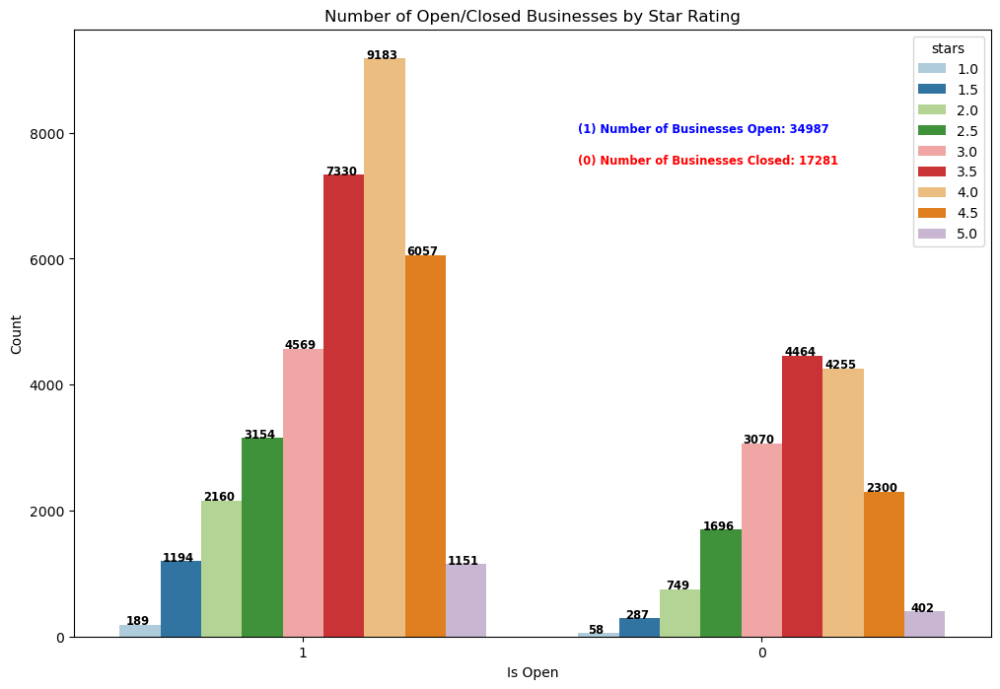

In [21]:
plt.figure(figsize=(12,8))
ax = sns.countplot(hue='stars', x='is_open'  , data =restaurants_eda, palette='Paired')
ax.set_ylabel('Count')
ax.set_xlabel('Is Open')
ax.set_title('Number of Open/Closed Businesses by Star Rating')


num_open , num_closed = restaurants_eda['is_open'].value_counts()

ax.text(0.6, 8000,
        '(1) Number of Businesses Open: {:.0f}'.format(num_open),
        weight='bold',
        color='blue',
        size='small')

ax.text(0.6, 7500,
        '(0) Number of Businesses Closed: {:.0f}'.format(num_closed),
        weight='bold',
        color='red',
        size='small')



for p in ax.patches:
        width, height = p.get_width(), p.get_height()
        x, y = p.get_xy() 
        ax.text(x+width-.05, 
                y+height,
                '{:.0f}'.format(height),
                weight='bold',
                horizontalalignment='center',
                size='small') 

plt.show()

The stars distribution doesn´t seem to be influenciated of the `is Open` variable since it has the same star rating distribution for both of its values

#### Checking states

In [22]:
restaurants_eda.state.unique()

array(['PA', 'TN', 'MO', 'FL', 'IN', 'AB', 'NV', 'IL', 'AZ', 'LA', 'NJ',
       'CA', 'DE', 'ID', 'NC', 'CO', 'HI', 'MT', 'XMS'], dtype=object)

As `XMS` is not an USA state, we will check the adress of those restaurantes with this value for the `state` column.

In [23]:
restaurants_eda[restaurants_eda.state=='XMS']

,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,categories
34288,Pumpernickles Catering,95a Mount Pleasant,Liverpool,XMS,L3 5TB,38.67305,-90.423157,4.0,5,1,"Caterers, Breakfast & Brunch, Convenience Stor..."


As `XMS` is not in USA nor Canada, we decide to drop this restaurant.

In [24]:
restaurants_eda = restaurants_eda.drop(index = restaurants_eda.index[restaurants_eda.state=='XMS'],
                                       axis=0).reset_index(drop=True)

In [25]:
restaurants_eda.state.unique()

array(['PA', 'TN', 'MO', 'FL', 'IN', 'AB', 'NV', 'IL', 'AZ', 'LA', 'NJ',
       'CA', 'DE', 'ID', 'NC', 'CO', 'HI', 'MT'], dtype=object)

In [26]:
restaurants_eda.shape

(52267, 11)

#### Restaurants ~ States

Text(0.5, 1.0, 'Top states by businesses listed')

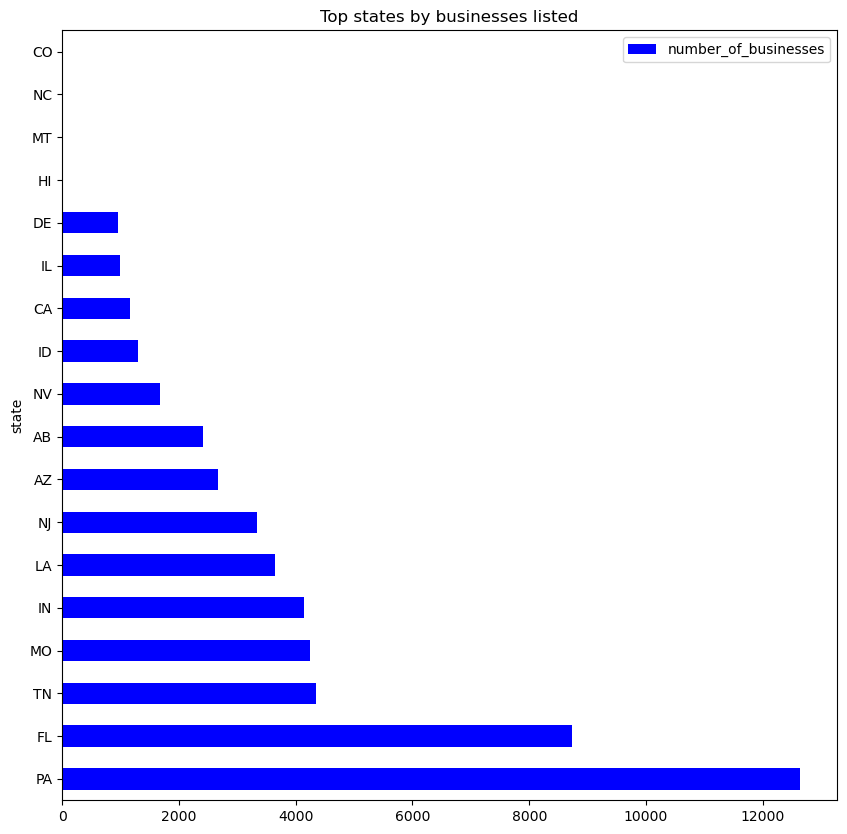

In [27]:
# Group data and sort by state for counting the businesses.
state_restaurants_counts = restaurants[['state', 'business_id']].groupby(['state'])\
['business_id'].agg('count').sort_values(ascending=False)

state_restaurants_counts = pd.DataFrame(data=state_restaurants_counts)
state_restaurants_counts.rename(columns={'business_id' : 'number_of_businesses'}, inplace=True)

state_restaurants_counts[:-1].sort_values(ascending=False, by="number_of_businesses")\
.plot(kind='barh', stacked=False, figsize=[10,10], colormap='winter')
plt.title('Top states by businesses listed')

As we can see, the top 3 states with more restaurants are Pennsylvania, Florida and Tennessee.

#### Reviews ~ States

Text(0.5, 1.0, 'Top states by reviews')

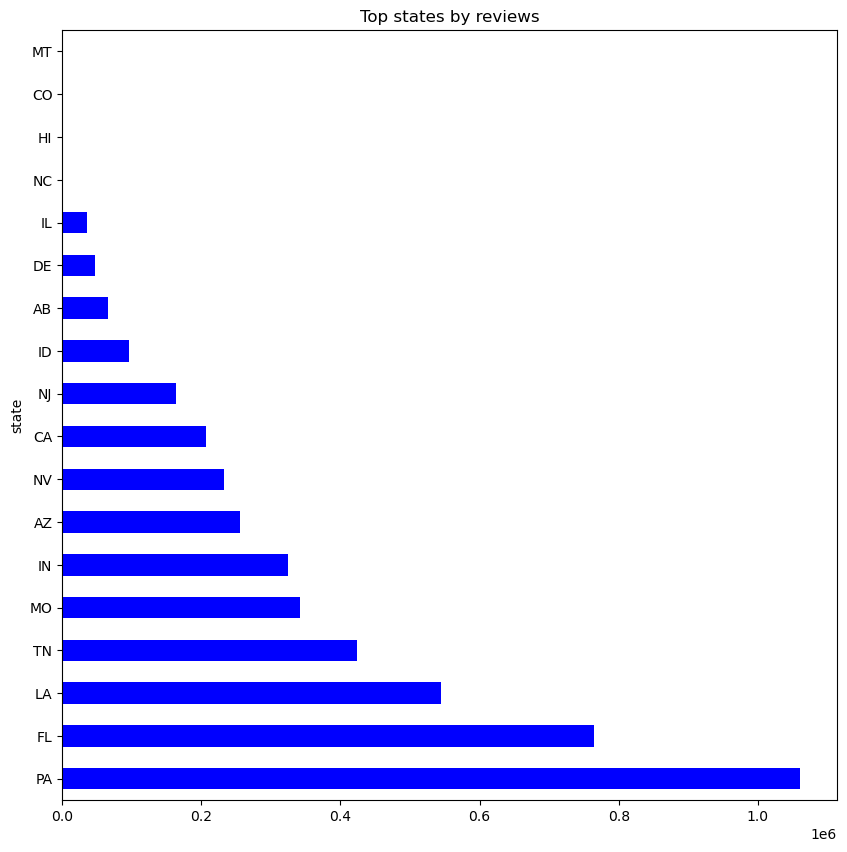

In [28]:
# Group data and sort by state for counting the reviews.
state_restaurants_reviews = restaurants_eda[['state', 'review_count', 'stars']].groupby(['state']).\
agg({'review_count': 'sum', 'stars': 'mean'}).sort_values(by='review_count', ascending=False)
state_restaurants_reviews['review_count'].plot(kind='barh', stacked=False, figsize=[10,10],\
                                                 colormap='winter')
plt.title('Top states by reviews')

As we can see, the top 3 states with more reviews are Pennsylvania, Florida and Los Angeles. Furthermore, it seems that if in a state the are more restaurants, there are also more reviews,something that we had already suspected before.

#### Top States with higher star rating (>50k reviews)

Here, we represent those states with a considerable number of reviews (>50K) sorted by the average star rating of their restaurants.

Text(0.5, 1.0, 'States with greater than 50k reviews ranked by average stars')

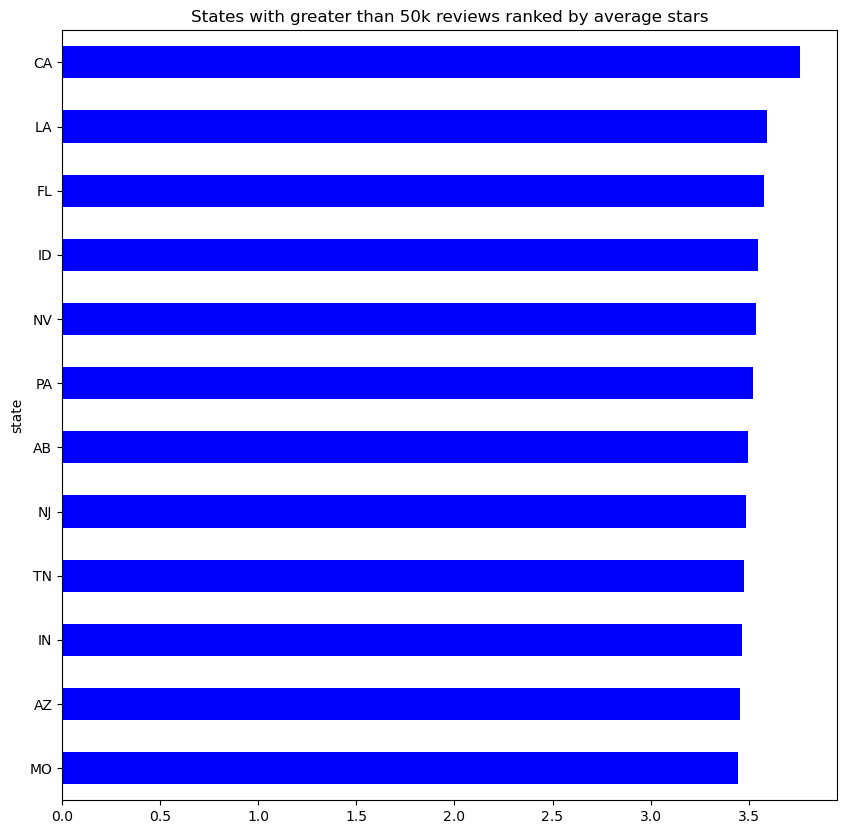

In [29]:
# Group data and sort by stars rating for counting the reviews.
state_restaurants_reviews[state_restaurants_reviews.review_count > 50000]['stars'].sort_values()\
.plot(kind='barh', stacked=False, figsize=[10,10], colormap='winter')
plt.title('States with greater than 50k reviews ranked by average stars')

California, Los Angeles and Florida has the highest average star rating on their reviews.

Now, we will analyze the same information grouped by cities instead of by state.

#### Restaurants ~ Cities

Text(0.5, 1.0, 'Top 50 cities by businesses listed')

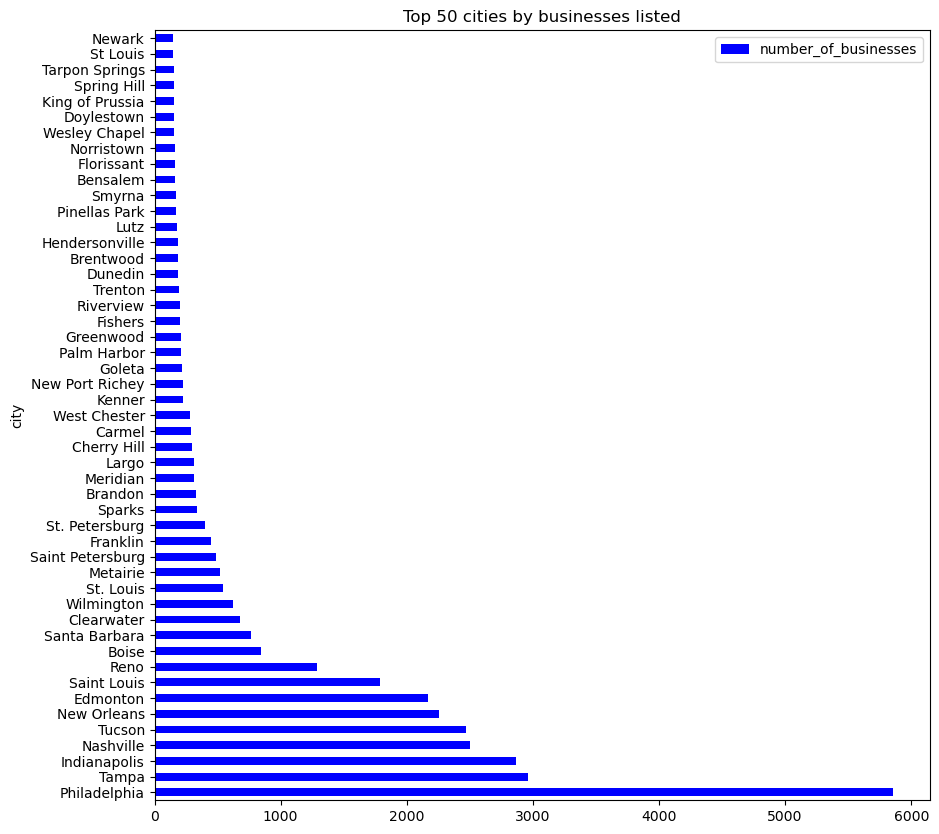

In [30]:
# Group data and sort by city for counting the businesses.
city_restaurants_counts = restaurants[['city', 'business_id']].groupby(['city'])\
['business_id'].agg('count').sort_values(ascending=False)

city_restaurants_counts = pd.DataFrame(data=city_restaurants_counts)
city_restaurants_counts.rename(columns={'business_id' : 'number_of_businesses'}, inplace=True)

city_restaurants_counts[0:49].sort_values(ascending=False, by="number_of_businesses")\
.plot(kind='barh', stacked=False, figsize=[10,10], colormap='winter')
plt.title('Top 50 cities by businesses listed')

As we can see, the top 3 cities with more restaurants are Philadelphia, Tampa and Indianapolis.

#### Reviews ~ Cities

Text(0.5, 1.0, 'Top 50 cities by reviews')

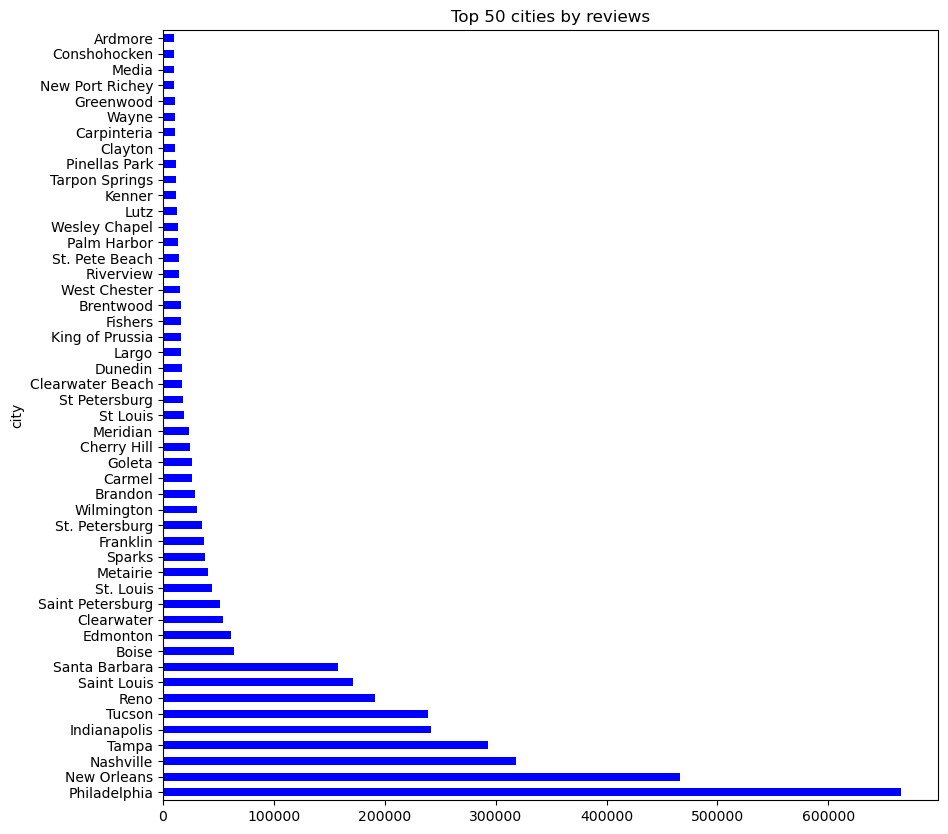

In [31]:
# Group data and sort by city for counting the reviews.
city_restaurants_reviews = restaurants_eda[['city', 'review_count', 'stars']].groupby(['city']).\
agg({'review_count': 'sum', 'stars': 'mean'}).sort_values(by='review_count', ascending=False)
city_restaurants_reviews['review_count'][0:49].plot(kind='barh', stacked=False, figsize=[10,10],\
                                                 colormap='winter')
plt.title('Top 50 cities by reviews')

As we can see, the top 3 cities with more reviews are Philadelphia, New Orleans and Nashville. Furthermore, it seems that if in a state the are more restaurants, there are also more reviews.Furthermore, it seems that if in a state the are more restaurants, there are also more reviews,something that we had already suspected before.

#### Top cities with higher star rating (>50k reviews)

Text(0.5, 1.0, 'Cities with greater than 50k reviews ranked by average stars')

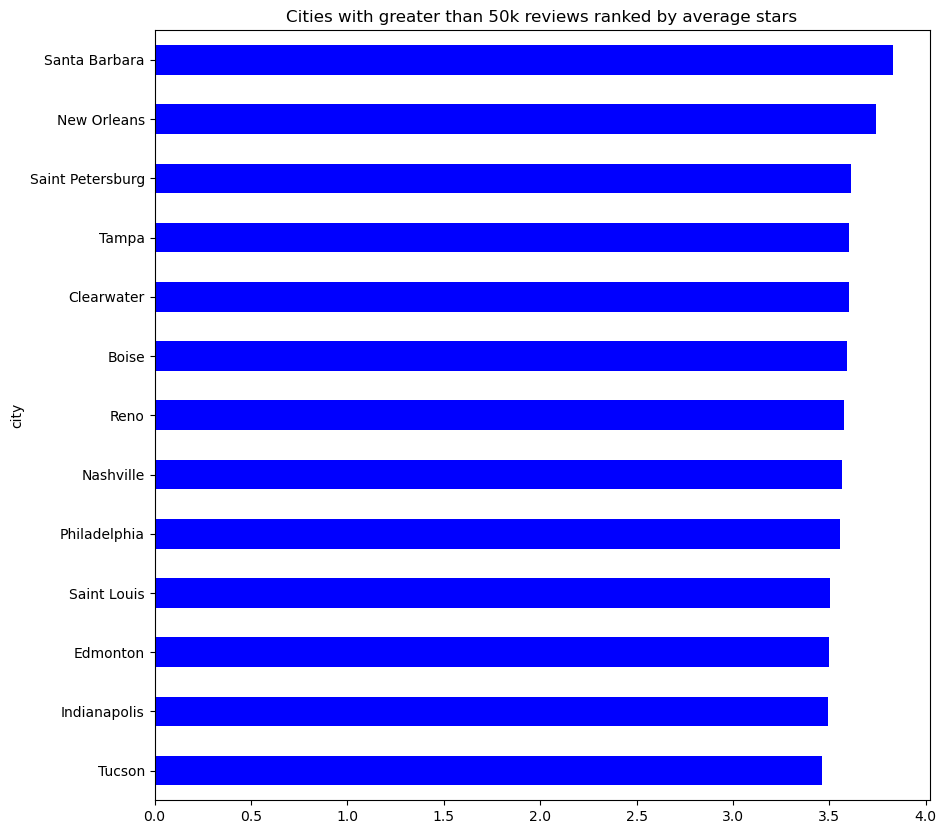

In [32]:
# Group data and sort by stars rating for counting the reviews.
city_restaurants_reviews[city_restaurants_reviews.review_count > 50000]['stars'].sort_values()\
.plot(kind='barh', stacked=False, figsize=[10,10], colormap='winter')
plt.title('Cities with greater than 50k reviews ranked by average stars')

Santa Barbara, New Orleans and Saint Petersburg has the highest average star rating on their reviews.The information by city is in good agreement with the information analyzed above by state, since Santa Barbara belongs to the state of California and Saint Petersburg belongs to the state of Florida.

### Data formmating

We will further analyze the categories and attributes columns as we believe they contain valuable information for the model.

#### Categories

In [33]:
restaurants_eda = restaurants.copy()
restaurants_eda.drop(['business_id', 'hours'],axis = 1, inplace = True)

We have eliminated those observations belonging to the XMS state since this is erroneous information as it belongs to Europe. 

In [34]:
restaurants_eda = restaurants_eda.drop(index = restaurants_eda.index[restaurants_eda.state=='XMS'],
                                       axis=0).reset_index(drop=True)

In [35]:
restaurants_eda.shape

(52267, 12)

We analyze which are the most common words in `categories`.

In [36]:
words_counter(restaurants, 'categories', 100)

,word,count
0,Restaurants,52343
1,Food,28462
2,&,20298
3,Bars,16076
4,American,15046
...,...,...
95,Korean,497
96,Donuts,475
97,Flavor,451
98,Tapas/Small,440


We transform the categories column into a completely new one. We take as a reference the most frequent words analyzed previously and create new categories.

In [37]:
# Listing categories to focus:
keywords = ['American','Breakfast','Traditional','Sandwiches','Burgers',
            'Mexican', 'Italian','Seafood','Chicken','Chinese','Meat',
            'Japanese','Asian','Steakhouses','Fast','Mediterranean',
            'Vegetarian','Soup','Thai','Southern','Cajun/Creole', 'Bars',
            'Breweries','Vegan','Vietnamese','Indian','Greek','Buffets']

# Creating a column for each category individually, if a rows cointains 
# that category, it will have the value 1, otherwise, it will be 0.
# If a rows doesn´t contain any of these categories, we create another 
# column named 'Other'.
restaurants_eda = restaurants_eda.assign(**{keyword: ['1' if keyword.lower() in categories.lower() 
                                              else '0' for categories in restaurants_eda['categories']] 
                                              for keyword in keywords},
                                         Other=['1' if all(keyword.lower() not in categories.lower() 
                                                         for keyword in keywords) 
                                                else '0' for categories in restaurants_eda['categories']])

restaurants_eda = restaurants_eda.drop('categories',axis=1)

In [38]:
# plot horizontal barplot for each column
sum_df = (restaurants_eda.copy()).iloc[:,11:]
sum_df = sum_df.astype('float32')
sum_df = pd.DataFrame(sum_df.sum(), columns=['count'])
sum_df = sum_df.astype({'count': 'int64'})
sum_df = sum_df.sort_values(by='count')
sum_df

,count
Meat,228
Breweries,407
Buffets,622
Greek,779
Indian,838
Vietnamese,852
Vegan,856
Cajun/Creole,923
Thai,971
Southern,988


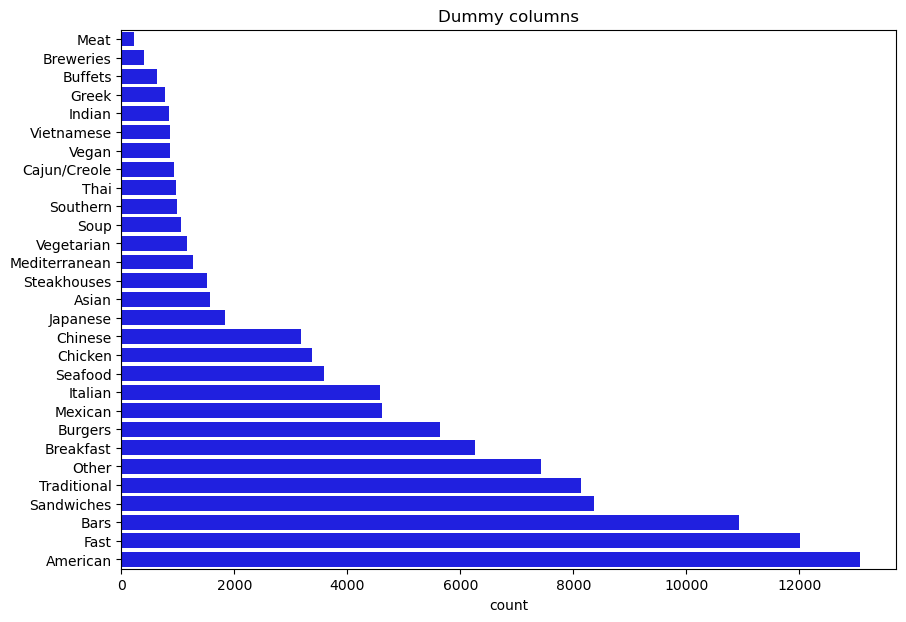

In [39]:
# Plotting the numbers of business grouped by the new dummy categories
plt.figure(figsize=(10, 7))
sns.barplot(x='count', y=sum_df.index, data=sum_df, orient='h',color='blue')
plt.title('Dummy columns')
plt.show()

#### Graphs

Now we are going to make use of graphs to check similarities of restaurants based on their categories. So we need a dataframe with the name, city and category of the restaurant

In [40]:
restaurants_graph = restaurants_eda.copy()
restaurants_graph = restaurants_graph[['name','city','American','Breakfast','Traditional','Sandwiches',
                                       'Burgers','Mexican', 'Italian','Seafood','Chicken','Chinese',
                                       'Meat','Japanese','Asian','Steakhouses','Fast','Mediterranean',
                                       'Vegetarian','Soup','Thai','Southern','Cajun/Creole', 'Bars',
                                       'Breweries','Vegan','Vietnamese','Indian','Greek','Buffets']]

In [41]:
restaurants_graph.head()

,name,city,American,Breakfast,Traditional,Sandwiches,Burgers,Mexican,Italian,Seafood,...,Thai,Southern,Cajun/Creole,Bars,Breweries,Vegan,Vietnamese,Indian,Greek,Buffets
0,St Honore Pastries,Philadelphia,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Sonic Drive-In,Ashland City,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Tsevi's Pub And Grill,Affton,1,0,1,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
3,Sonic Drive-In,Nashville,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Vietnamese Food Truck,Tampa Bay,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


As we need unique restaurants, we modify the column name to make it unique (if two restaurants are "Mc'Donals", the second one would be "Mc'Donals_2"). Moreover, we unpivot the table to get one column named `category` in order to match the name with the category of the restaurant.

In [42]:
restaurants_graph = column_to_unique(restaurants_graph,'name')

In [43]:
restaurants_graph = melt_categories(restaurants_graph)

In [44]:
restaurants_graph.head()

,name,city,Category
2,Tsevi's Pub And Grill,Affton,American
5,Denny's,Indianapolis,American
18,Craft Hall,Philadelphia,American
22,Caviar & Bananas,Nashville,American
25,Roman Forum,Tampa,American


Choose the city to filter the graph: 
Sewell
Graph with 89 nodes and 152 edges


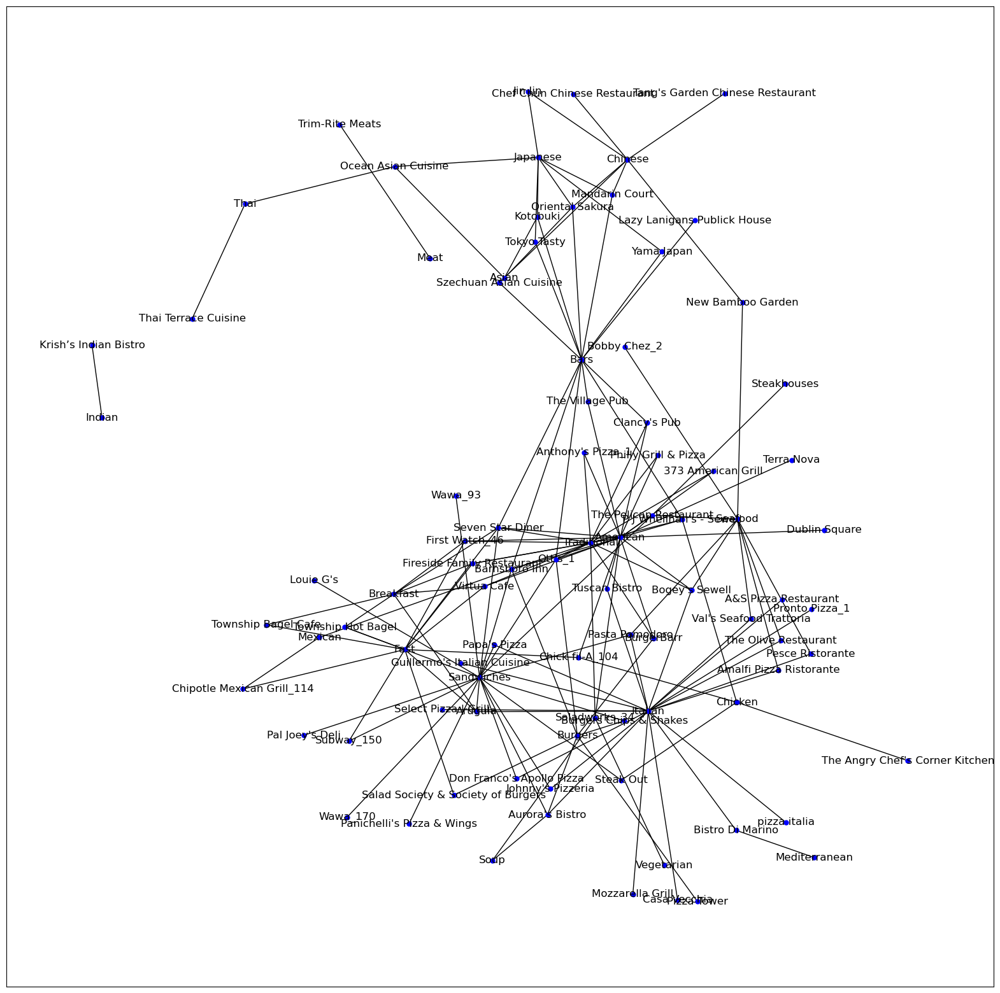

In [45]:
graph_restaurants_categories(restaurants_graph)

As we can see, there is an 'asian' zone conected on the top of the graph (Chinese - Japanese - Asian - Thai).  On the bottom-right we have another zone more 'Traditional' with sticks, burguers, sandwiches, italian, american, etc. There are other relations such us Italian and Mediterranean.

#### Attributes

The attributes column is a dictionary. Let's analyze it further and transform it into several columns with the attributes that we think provide the most relevant information.

In [46]:
import warnings
# Ignore warnings
warnings.simplefilter("ignore")
pd.options.display.max_columns = 40
# Converting the dictionary to dataframe
attributes = restaurants_eda["attributes"].apply(pd.Series)
# Replace None values with NaN
attributes.fillna(value=pd.np.nan,inplace=True)
attributes.head()

,AcceptsInsurance,AgesAllowed,Alcohol,Ambience,BYOB,BYOBCorkage,BestNights,BikeParking,BusinessAcceptsBitcoin,BusinessAcceptsCreditCards,BusinessParking,ByAppointmentOnly,Caters,CoatCheck,Corkage,DietaryRestrictions,DogsAllowed,DriveThru,GoodForDancing,GoodForKids,GoodForMeal,HairSpecializesIn,HappyHour,HasTV,Music,NoiseLevel,Open24Hours,OutdoorSeating,RestaurantsAttire,RestaurantsCounterService,RestaurantsDelivery,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsReservations,RestaurantsTableService,RestaurantsTakeOut,Smoking,WheelchairAccessible,WiFi
0,NaN,NaN,u'none',NaN,NaN,NaN,NaN,True,NaN,False,"{'garage': False, 'street': True, 'validated':...",False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,False,NaN,1,NaN,NaN,True,NaN,NaN,u'free'
1,NaN,NaN,u'none',None,NaN,NaN,NaN,False,NaN,True,None,False,False,False,NaN,NaN,False,True,NaN,True,NaN,NaN,False,True,NaN,NaN,NaN,True,u'casual',NaN,True,True,1,False,False,True,NaN,True,u'no'
2,NaN,NaN,u'full_bar',"{'romantic': False, 'intimate': False, 'touris...",NaN,NaN,NaN,NaN,NaN,True,"{'garage': False, 'street': False, 'validated'...",NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,True,NaN,u'average',NaN,True,u'casual',NaN,False,True,1,False,NaN,True,NaN,NaN,u'free'
3,NaN,NaN,u'none',NaN,NaN,NaN,NaN,NaN,NaN,True,"{'garage': False, 'street': False, 'validated'...",False,False,False,NaN,NaN,False,True,NaN,True,NaN,NaN,False,True,NaN,NaN,NaN,True,'casual',NaN,True,False,1,False,False,True,NaN,True,u'no'
4,NaN,NaN,'none',"{'touristy': False, 'hipster': False, 'romanti...",NaN,NaN,NaN,NaN,NaN,NaN,"{'garage': False, 'street': False, 'validated'...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{'dessert': False, 'latenight': False, 'lunch'...",NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN


In [47]:
restaurants_eda.drop(['attributes'],axis = 1, inplace = True)

In [48]:
attributes.shape

(52267, 39)

In order to avoid subjetivity, we drop the columns `GoodForKids`, `RestaurantsGoodForGroups`, `BestNights`, `NoiseLevel`, `GoodForDancing`, `GoodForMeal`, and `Ambience`.

In [49]:
attributes = attributes.drop(['GoodForKids','RestaurantsGoodForGroups','BestNights',
                              'NoiseLevel','GoodForDancing','Ambience','GoodForMeal'], axis=1)

In [50]:
#Evaluating the null elements in the dataset:
pd_null_columnas = pd.DataFrame(attributes.isnull().sum().sort_values(ascending=False), columns=['nulos_columnas'])     
pd_null_filas = pd.DataFrame(attributes.isnull().sum(axis=1).sort_values(ascending=False), columns=['nulos_filas'])
#Getting the proportions:
pd_null_columnas['Proporcion_columnas'] = pd_null_columnas['nulos_columnas']/attributes.shape[0]
pd_null_filas['Proporcion_filas'] = pd_null_filas['nulos_filas']/attributes.shape[1]

In [51]:
# nulls (columns) display:
pd_null_columnas

,nulos_columnas,Proporcion_columnas
HairSpecializesIn,52265,0.999962
RestaurantsCounterService,52249,0.999656
AcceptsInsurance,52248,0.999636
Open24Hours,52246,0.999598
DietaryRestrictions,52237,0.999426
AgesAllowed,52179,0.998316
BYOBCorkage,50825,0.972411
ByAppointmentOnly,48921,0.935983
Corkage,48835,0.934337
Smoking,48820,0.934050


We have decided to keep those attributes that have less than 25% null values.

In [52]:
attributes = attributes.loc[:,(pd_null_columnas.index[pd_null_columnas.Proporcion_columnas<0.25]).tolist()]

In [53]:
#Evaluating the null elements in the dataset:
pd_null_columnas = pd.DataFrame(attributes.isnull().sum().sort_values(ascending=False), columns=['nulos_columnas'])     
pd_null_filas = pd.DataFrame(attributes.isnull().sum(axis=1).sort_values(ascending=False), columns=['nulos_filas'])
#Getting the proportions:
pd_null_columnas['Proporcion_columnas'] = pd_null_columnas['nulos_columnas']/attributes.shape[0]
pd_null_filas['Proporcion_filas'] = pd_null_filas['nulos_filas']/attributes.shape[1]

In [54]:
# nulls (columns) display:
pd_null_columnas

,nulos_columnas,Proporcion_columnas
Alcohol,12287,0.235081
HasTV,10350,0.198022
RestaurantsReservations,9161,0.175273
OutdoorSeating,8628,0.165075
RestaurantsPriceRange2,7768,0.148622
BusinessAcceptsCreditCards,6710,0.128379
BusinessParking,6657,0.127365
RestaurantsDelivery,4613,0.088258
RestaurantsTakeOut,3555,0.068016


In [55]:
# nulls (rows) display:
pd_null_filas.groupby('nulos_filas').count()

,Proporcion_filas
nulos_filas,
0,31860
1,6262
2,3055
3,2548
4,2516
5,1609
6,1532
7,1398
8,757


In [56]:
attributes.head()

,Alcohol,HasTV,RestaurantsReservations,OutdoorSeating,RestaurantsPriceRange2,BusinessAcceptsCreditCards,BusinessParking,RestaurantsDelivery,RestaurantsTakeOut
0,u'none',NaN,NaN,False,1,False,"{'garage': False, 'street': True, 'validated':...",False,True
1,u'none',True,False,True,1,True,None,True,True
2,u'full_bar',True,False,True,1,True,"{'garage': False, 'street': False, 'validated'...",False,True
3,u'none',True,False,True,1,True,"{'garage': False, 'street': False, 'validated'...",True,True
4,'none',NaN,False,None,NaN,NaN,"{'garage': False, 'street': False, 'validated'...",NaN,NaN


In [57]:
attributes.shape

(52267, 9)

##### Alcohol attribute processing

In [58]:
attributes['Alcohol'].unique()

array(["u'none'", "u'full_bar'", "'none'", "'full_bar'",
       "u'beer_and_wine'", nan, "'beer_and_wine'", 'None'], dtype=object)

In [59]:
# Replace the "u'full_bar'", "'full_bar'", "u'beer_and_wine'"" and "'beer_and_wine'" values with 'Yes' and Replace the "u'none'", 'None', and "'none'" values with 'No'
attributes['Alcohol'] = attributes['Alcohol'].replace(
    ["u'full_bar'", "'full_bar'","u'beer_and_wine'", "'beer_and_wine'"], 'Yes').replace(
    ["u'none'", "'none'", 'None'], 'No')
# Fill nan with 'Unknown'
attributes['Alcohol'] = attributes['Alcohol'].fillna('Unknown')

##### HasTV attribute processing

In [60]:
attributes['HasTV'].unique()

array([nan, 'True', 'False', 'None'], dtype=object)

In [61]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['HasTV'] = attributes['HasTV'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['HasTV'] = attributes['HasTV'].fillna('Unknown')

##### RestaurantsReservations attribute processing

In [62]:
attributes['RestaurantsReservations'].unique()

array([nan, 'False', 'True', 'None'], dtype=object)

In [63]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['RestaurantsReservations'] = attributes['RestaurantsReservations'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['RestaurantsReservations'] = attributes['RestaurantsReservations'].fillna('Unknown')

##### OutdoorSeating attribute processing

In [64]:
attributes['OutdoorSeating'].unique()

array(['False', 'True', 'None', nan], dtype=object)

In [65]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['OutdoorSeating'] = attributes['OutdoorSeating'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['OutdoorSeating'] = attributes['OutdoorSeating'].fillna('Unknown')

#####  RestaurantsPriceRange2	

In [66]:
attributes['RestaurantsPriceRange2'].unique()

array(['1', nan, '2', '3', '4', 'None'], dtype=object)

In [67]:
# Replace the 1 and 2 values with 'Cheap', the 3 and 4 values with 'Expensive' and  the 'None' values with Nan
attributes['RestaurantsPriceRange2'] = pd.to_numeric(attributes['RestaurantsPriceRange2'], errors='coerce')
attributes['RestaurantsPriceRange2'] = attributes['RestaurantsPriceRange2'].replace(
    [1,2], 'Cheap').replace(
    [3,4], 'Expensive')
# Fill nan with 'Unknown'
attributes['RestaurantsPriceRange2'] = attributes['RestaurantsPriceRange2'].fillna('Unknown')

##### BusinessAcceptsCreditCards attribute processing	

In [68]:
attributes['BusinessAcceptsCreditCards'].unique()

array(['False', 'True', nan, 'None'], dtype=object)

In [69]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['BusinessAcceptsCreditCards'] = attributes['BusinessAcceptsCreditCards'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['BusinessAcceptsCreditCards'] = attributes['BusinessAcceptsCreditCards'].fillna('Unknown')

##### RestaurantsDelivery attribute processing

In [70]:
attributes['RestaurantsDelivery'].unique()

array(['False', 'True', nan, 'None'], dtype=object)

In [71]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['RestaurantsDelivery'] = attributes['RestaurantsDelivery'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['RestaurantsDelivery'] = attributes['RestaurantsDelivery'].fillna('Unknown')

##### RestaurantsTakeOut attribute processing

In [72]:
attributes['RestaurantsTakeOut'].unique()

array(['True', nan, 'None', 'False'], dtype=object)

In [73]:
# Replace the 'True' values with 'Yes' and  the 'False' and 'None' values with 'No'
attributes['RestaurantsTakeOut'] = attributes['RestaurantsTakeOut'].replace(
    'True', 'Yes').replace(
    ['False', 'None'], 'No')
# Fill nan with 'Unknown'
attributes['RestaurantsTakeOut'] = attributes['RestaurantsTakeOut'].fillna('Unknown')

##### BusinessParking attribute processing	

This attribute has the values: street, lot, garage, validated and valet. We consider 'garage', 'validated', 'valet' better than the others so we recode the varible to premium parking or not.

In [74]:
# We pass each value to a function to unpack the dictionary and join the keys if true. 
attributes['BusinessParking'] = attributes['BusinessParking'].apply(lambda x: extract_true_values(ast.literal_eval(x)) 
                                                         if isinstance(x, str) else pd.np.nan)
attributes['BusinessParking'].unique()

array(['street', 'None', 'lot', nan, 'street + lot',
       'garage + validated + valet', 'garage', 'garage + street',
       'validated', 'street + valet', 'lot + valet',
       'garage + street + validated + lot + valet',
       'garage + street + lot', 'street + validated + lot',
       'garage + lot', 'valet + garage', 'valet', 'street + lot + valet',
       'garage + valet', 'street + lot + validated',
       'garage + street + validated + lot', 'garage + validated',
       'garage + street + validated', 'street + validated + valet',
       'garage + street + valet', 'validated + lot',
       'garage + lot + valet', 'street + validated',
       'garage + street + lot + valet', 'garage + validated + lot',
       'valet + street + lot', 'garage + street + validated + valet',
       'validated + valet', 'validated + lot + valet',
       'valet + validated', 'valet + garage + street',
       'street + validated + lot + valet', 'valet + lot',
       'valet + street + validated', 'valet

In [75]:
attributes['Premium_Parking'] = attributes['BusinessParking'].apply(has_target_words)
attributes['Premium_Parking'].unique()

array(['No', 'Unknown', 'Yes'], dtype=object)

In [76]:
attributes = attributes.drop('BusinessParking',axis=1)

In [77]:
attributes.shape

(52267, 9)

In [78]:
restaurants_eda.shape

(52267, 39)

##### Join all attributes variables

In [79]:
restaurants_eda = pd.concat([restaurants_eda, attributes], axis=1)
restaurants_eda.head()

,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,American,Breakfast,Traditional,Sandwiches,Burgers,Mexican,Italian,Seafood,Chicken,Chinese,...,Thai,Southern,Cajun/Creole,Bars,Breweries,Vegan,Vietnamese,Indian,Greek,Buffets,Other,Alcohol,HasTV,RestaurantsReservations,OutdoorSeating,RestaurantsPriceRange2,BusinessAcceptsCreditCards,RestaurantsDelivery,RestaurantsTakeOut,Premium_Parking
0,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155563,4.0,80,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,1,No,Unknown,Unknown,No,Cheap,No,No,Yes,No
1,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269592,-87.058945,2.0,6,1,0,0,0,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,No,Yes,No,Yes,Cheap,Yes,Yes,Yes,No
2,Tsevi's Pub And Grill,8025 Mackenzie Rd,Affton,MO,63123,38.565166,-90.321083,3.0,19,0,1,0,1,0,0,0,1,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,Yes,Yes,No,Yes,Cheap,Yes,No,Yes,No
3,Sonic Drive-In,2312 Dickerson Pike,Nashville,TN,37207,36.208103,-86.768173,1.5,10,1,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,No,Yes,No,Yes,Cheap,Yes,Yes,Yes,Unknown
4,Vietnamese Food Truck,,Tampa Bay,FL,33602,27.955269,-82.456322,4.0,10,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0,0,No,Unknown,No,No,Unknown,Unknown,Unknown,Unknown,Unknown


#### Parquet

We are going to save the data extrated in a parquet format.

In [81]:
# list of dataframes to convert
dataframes=[restaurants_eda]

# List of file names
filenames =["../data/restaurants_cleaned.parquet" ] 
             
# Convert each dataframe to a Parquet file
save_dfs_to_parquet(dataframes, filenames)

#### Correlation analysis

In [82]:
# Matriz con valores de la V de Cramer
df = restaurants_eda.copy()
# define the list of column names you want to exclude
excluded_columns = ['name', 'address', 'stars','is_open','review_count',
                  'postal_code','latitude','longitude']

# get a list of all column names in the data frame
all_columns = df.columns.tolist()

# use the difference method to get the column names that are not in the excluded_columns list
selected_columns = list(set(all_columns).difference(set(excluded_columns)))
selected_columns
rows= []
for var1 in selected_columns:
  col = []
  for var2 in selected_columns :

    cramers =cramers_corrected_stat(df[var1], df[var2]) # Test V de Cramer
    col.append(round(cramers,2)) 
  rows.append(col)

cramers_results = np.array(rows)
cramer_matrix = pd.DataFrame(cramers_results, columns = selected_columns, index = selected_columns)
cramer_matrix

,Cajun/Creole,Breweries,Vietnamese,Vegan,Greek,Southern,Chicken,Fast,Alcohol,state,RestaurantsReservations,HasTV,American,Chinese,Vegetarian,Breakfast,Sandwiches,Italian,Steakhouses,Traditional,Mexican,BusinessAcceptsCreditCards,RestaurantsPriceRange2,RestaurantsDelivery,Meat,Japanese,Asian,Other,OutdoorSeating,Seafood,city,Buffets,Burgers,RestaurantsTakeOut,Mediterranean,Soup,Premium_Parking,Thai,Indian,Bars
Cajun/Creole,1.00,0.01,0.01,0.01,0.02,0.12,0.00,0.02,0.08,0.26,0.04,0.02,0.01,0.03,0.02,0.00,0.02,0.03,0.00,0.00,0.03,0.02,0.03,0.04,0.00,0.02,0.01,0.05,0.02,0.18,0.27,0.01,0.02,0.02,0.02,0.01,0.02,0.02,0.01,0.01
Breweries,0.01,1.00,0.01,0.01,0.01,0.00,0.01,0.04,0.08,0.04,0.03,0.03,0.07,0.02,0.01,0.02,0.01,0.02,0.01,0.05,0.02,0.01,0.02,0.02,0.00,0.02,0.01,0.04,0.06,0.01,0.00,0.01,0.00,0.00,0.01,0.01,0.04,0.01,0.01,0.08
Vietnamese,0.01,0.01,1.00,0.00,0.02,0.01,0.03,0.06,0.02,0.09,0.03,0.02,0.06,0.06,0.02,0.04,0.01,0.04,0.02,0.05,0.04,0.04,0.02,0.01,0.01,0.00,0.10,0.05,0.06,0.02,0.07,0.01,0.04,0.01,0.02,0.06,0.02,0.07,0.01,0.03
Vegan,0.01,0.01,0.00,1.00,0.00,0.01,0.02,0.02,0.03,0.03,0.01,0.10,0.03,0.02,0.37,0.00,0.01,0.02,0.02,0.03,0.01,0.00,0.04,0.02,0.00,0.01,0.01,0.05,0.03,0.02,0.00,0.01,0.03,0.01,0.01,0.01,0.03,0.01,0.06,0.02
Greek,0.02,0.01,0.02,0.00,1.00,0.00,0.01,0.02,0.03,0.06,0.02,0.03,0.02,0.03,0.01,0.01,0.00,0.00,0.01,0.01,0.03,0.01,0.01,0.02,0.00,0.02,0.02,0.05,0.03,0.00,0.06,0.01,0.03,0.02,0.40,0.00,0.02,0.02,0.01,0.04
Southern,0.12,0.00,0.01,0.01,0.00,1.00,0.05,0.03,0.04,0.14,0.02,0.03,0.07,0.03,0.01,0.06,0.01,0.03,0.00,0.07,0.03,0.02,0.00,0.01,0.00,0.03,0.02,0.06,0.02,0.04,0.13,0.00,0.01,0.01,0.01,0.01,0.04,0.02,0.01,0.00
Chicken,0.00,0.01,0.03,0.02,0.01,0.05,1.00,0.05,0.07,0.06,0.10,0.05,0.03,0.05,0.03,0.06,0.07,0.06,0.00,0.07,0.07,0.03,0.05,0.12,0.01,0.04,0.02,0.11,0.07,0.00,0.10,0.01,0.01,0.04,0.02,0.02,0.07,0.03,0.02,0.02
Fast,0.02,0.04,0.06,0.02,0.02,0.03,0.05,1.00,0.22,0.10,0.20,0.05,0.04,0.10,0.02,0.68,0.11,0.10,0.05,0.07,0.01,0.03,0.09,0.15,0.02,0.09,0.06,0.22,0.01,0.07,0.13,0.03,0.28,0.07,0.04,0.00,0.04,0.07,0.06,0.14
Alcohol,0.08,0.08,0.02,0.03,0.03,0.04,0.07,0.22,1.00,0.17,0.49,0.46,0.27,0.09,0.06,0.09,0.16,0.08,0.15,0.19,0.05,0.31,0.32,0.30,0.02,0.06,0.04,0.20,0.49,0.13,0.21,0.03,0.06,0.25,0.04,0.05,0.31,0.04,0.02,0.43
state,0.26,0.04,0.09,0.03,0.06,0.14,0.06,0.10,0.17,1.00,0.08,0.06,0.09,0.06,0.03,0.05,0.04,0.10,0.03,0.08,0.15,0.39,0.07,0.08,0.00,0.04,0.03,0.07,0.12,0.12,0.95,0.06,0.08,0.05,0.03,0.01,0.09,0.02,0.06,0.06


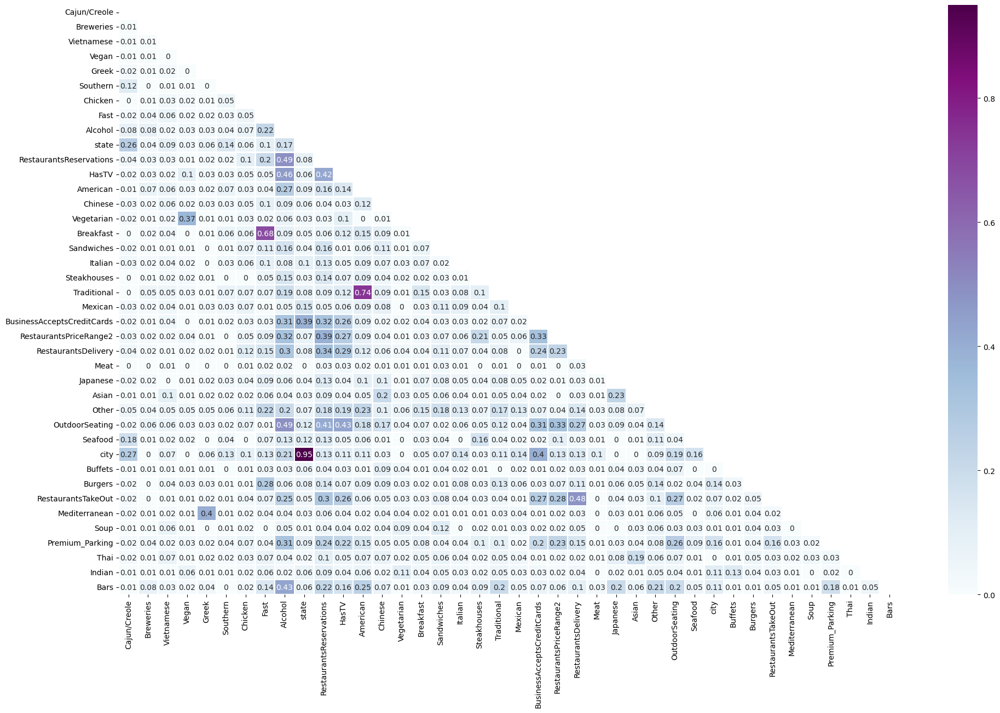

In [83]:
# Converting the correlation matrix to a triangular one
mask = np.zeros_like(cramer_matrix, dtype='bool')
mask[np.triu_indices_from(mask)] = True
# Plotting the final matrix:
fig, ax = plt.subplots(figsize=(23, 14))
ax.plot()
ax = sns.heatmap(cramer_matrix, mask=mask, annot=True, linewidths=0.9, cmap="BuPu", 
                 xticklabels=selected_columns, yticklabels=selected_columns)

As espected, city and state are almost full correlated. 
All these restaurants are in America so it´s natural that American food and Traditional food are correlated.
Categories suchs as Fast and Breakfast are correlated as well as Mediterranean and Greek.
About attributes, 'OutdoorSeating' and 'Bars are correlated with 'Alcohol'.
Also, RestaurantsTakeOut with RestaurantDelivery.

#### MAPS

Through the folium library we have been able to obtain an interactive map grouping the number of restaurants by coordinates. Each group contains the number of restaurants in that particular area and you can interact with it to get the location of each restaurant represented through a marker.

In [85]:
# Create a base map
map_restaurants = fl.Map(location=[39,-96], tiles='cartodbpositron', zoom_start=3)

# Add points to the map
mc = MarkerCluster()
for idx, row in restaurants.iterrows():
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        mc.add_child(Marker([row['latitude'], row['longitude']]))
map_restaurants.add_child(mc)

# Display the map
map_restaurants

In addition, we have represented a heatmap of the same library to better visualize this information.

In [86]:
# Create a base map
heatmap_restaurants = fl.Map(location=[39,-96], tiles='cartodbpositron', zoom_start=4)

# Add a heatmap to the base map
HeatMap(data=restaurants[['latitude', 'longitude']], radius=10).add_to(heatmap_restaurants)

# Display the map
heatmap_restaurants

### Reviews

We now analyze the data containing information about the reviews.

#### Display and dimensions

In [87]:
print('The reviews dataset has', reviews.shape[0], 'different reviews and', reviews.shape[1], 'variables.')
reviews.head()

The reviews dataset has 4724471 different reviews and 9 variables.


,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15
5,JrIxlS1TzJ-iCu79ul40cQ,eUta8W_HdHMXPzLBBZhL1A,04UD14gamNjLY0IDYVhHJg,1.0,1,2,1,I am a long term frequent customer of this est...,2015-09-23 23:10:31


####  Data types

In [88]:
reviews.dtypes

review_id      object
user_id        object
business_id    object
stars          object
useful          int32
funny           int32
cool            int32
text           object
date           object
dtype: object

#### Duplicate analysis

In [89]:
print(reviews['review_id'].shape[0], 'rows,', reviews['review_id'].drop_duplicates().shape[0], 
      'distinct reviews ->', 
      str(reviews['review_id'].shape[0]-reviews['review_id'].drop_duplicates().shape[0]), 
      'duplicates.')

4724471 rows, 4724471 distinct reviews -> 0 duplicates.


#### Descriptive analysis

In [90]:
# Numeric:
reviews.describe()

,useful,funny,cool
count,4.724471e+06,4.724471e+06,4.724471e+06
mean,9.840992e-01,3.013692e-01,4.795771e-01
std,2.739150e+00,1.717190e+00,2.159917e+00
min,-1.000000e+00,-1.000000e+00,-1.000000e+00
25%,0.000000e+00,0.000000e+00,0.000000e+00
50%,0.000000e+00,0.000000e+00,0.000000e+00
75%,1.000000e+00,0.000000e+00,0.000000e+00
max,4.200000e+02,7.920000e+02,4.040000e+02


In [91]:
# Categorical:
reviews[['stars','useful','funny','cool']].astype('str').describe(include='object')

,stars,useful,funny,cool
count,4724471,4724471,4724471,4724471
unique,5,225,190,201
top,5.0,0,0,0
freq,2079441,2755278,4017362,3645784


#### Outliers analysis

In [92]:
get_deviation_of_mean_perc(reviews, ['useful','funny','cool'], target='stars', multiplier=3)

index,1.0,2.0,3.0,4.0,5.0,variable,sum_outlier_values,porcentaje_sum_null_values
0,0.103683,0.073698,0.106192,0.308088,0.408339,useful,46623,0.009868
1,0.13601,0.096748,0.128778,0.298683,0.339781,funny,34843,0.007375
2,0.015763,0.02867,0.096193,0.371648,0.487725,cool,45866,0.009708


There are very few outliers so we decided not to eliminate them in order not to lose information.

#### NA's Analysis

In [93]:
# Evaluating the null elements in the dataset:
pd_null_columnas = pd.DataFrame(reviews.isnull().sum().sort_values(ascending=False), columns=['nulos_columnas'])     
pd_null_filas = pd.DataFrame(reviews.isnull().sum(axis=1).sort_values(ascending=False), columns=['nulos_filas'])
# Getting the proportions:
pd_null_columnas['Proporcion_columnas'] = pd_null_columnas['nulos_columnas']/reviews.shape[0]
pd_null_filas['Proporcion_filas'] = pd_null_filas['nulos_filas']/reviews.shape[1]

In [94]:
# nulls (rows) display:
pd_null_filas

,nulos_filas,Proporcion_filas
0,0,0.0
4649160,0,0.0
4649455,0,0.0
4649454,0,0.0
4649453,0,0.0
...,...,...
2304863,0,0.0
2304862,0,0.0
2304861,0,0.0
2304858,0,0.0


In [95]:
# nulls (columns) display:
pd_null_columnas

,nulos_columnas,Proporcion_columnas
review_id,0,0.0
user_id,0,0.0
business_id,0,0.0
stars,0,0.0
useful,0,0.0
funny,0,0.0
cool,0,0.0
text,0,0.0
date,0,0.0


There are no null values in the reviews data.

#### Stars distribution

In [96]:
# getting the percentage for the stars rating column classes:
reviews['stars'] = reviews['stars'].astype('float32')
fraude_percentage = reviews['stars']\
        .value_counts(normalize=True)\
        .mul(100).rename('Percentage').reset_index()
fraude_percentage_count = reviews['stars'].value_counts().reset_index()
fraude_percentage_distribution = pd.merge(fraude_percentage, fraude_percentage_count, on=['index'], how='inner')
fraude_percentage_distribution.set_index('index').sort_index()

,Percentage,stars
index,,
1.0,12.005259,567185
2.0,8.561509,404486
3.0,11.495636,543108
4.0,23.923334,1130251
5.0,44.014261,2079441


In [97]:
# plotting target distribution:
fig = px.pie(fraude_percentage_distribution, title='Stars distribution Pie', names="index", values='Percentage', hole=0.6)
fig.update_traces(textposition='outside')
fig.update_layout(legend_title_text='     Stars')
fig.show()

We can see that reviews with a rating higher than 3 stars(we will consider them later as positive reviews,good experience) account for approximately 70% of the total reviews.

### Users

We now analyze the data containing information about the users.

#### Display and dimensions

In [98]:
print('The users dataset has', users.shape[0], 'different reviews and', users.shape[1], 'variables.')
users.head()

The users dataset has 1445984 different reviews and 22 variables.


,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,3.91,250,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,3.74,1145,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,3.32,89,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,4.27,24,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,3.54,1,1,0,0,0,1,1,0,0,0,0


####  Data types

In [99]:
users.dtypes

user_id                object
name                   object
review_count            int32
yelping_since          object
useful                  int32
funny                   int32
cool                    int32
elite                  object
friends                object
fans                    int32
average_stars         float32
compliment_hot          int32
compliment_more         int32
compliment_profile      int32
compliment_cute         int32
compliment_list         int32
compliment_note         int32
compliment_plain        int32
compliment_cool         int32
compliment_funny        int32
compliment_writer       int32
compliment_photos       int32
dtype: object

#### Duplicate analysis

In [100]:
print(users['user_id'].shape[0], 'rows,', users['user_id'].drop_duplicates().shape[0], 
      'distinct users ->', 
      str(users['user_id'].shape[0]-users['user_id'].drop_duplicates().shape[0]), 
      'duplicates.')

1445984 rows, 1445984 distinct users -> 0 duplicates.


For this EDA, we are going to omit the  `user_id` as it's an identificator. The columns `friends` and `elite` will be omitted as well since they have an undesired format. We will decide how to treat them later.

In [101]:
users_eda = users.copy()
users_eda.drop(['user_id', 'friends', 'elite'],axis = 1, inplace = True)

In this dataset, stars (average_stars) isn't rounded. To follow the same scheme we round it to half-stars

In [102]:
users_eda['average_stars'] = users_eda['average_stars'].apply(lambda x: round(x * 2) / 2).astype('str')

#### Descriptive analysis

In [103]:
# Numeric:
users_eda.describe()

,review_count,useful,funny,cool,fans,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
count,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06,1.445984e+06
mean,2.814082e+01,5.187386e+01,2.110471e+01,2.996053e+01,1.815301e+00,2.241622e+00,3.608505e-01,2.238690e-01,1.646671e-01,8.042067e-02,1.793715e+00,3.737989e+00,3.525769e+00,3.525769e+00,1.327487e+00,1.543669e+00
std,9.374400e+01,7.360119e+02,4.679927e+02,6.486222e+02,2.088509e+01,8.320403e+01,1.475392e+01,1.738065e+01,1.314169e+01,1.166429e+01,6.953490e+01,1.335240e+02,1.082524e+02,1.082524e+02,3.630625e+01,1.093050e+02
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,3.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,7.000000e+00,3.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,2.000000e+01,1.500000e+01,3.000000e+00,4.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.747300e+04,2.062960e+05,1.858230e+05,1.998780e+05,1.249700e+04,2.578400e+04,1.350100e+04,1.418000e+04,1.365400e+04,1.266900e+04,5.903100e+04,1.010970e+05,4.996700e+04,4.996700e+04,1.593400e+04,8.263000e+04


In [104]:
# Categorical:
users_eda.describe(include='object')

,name,yelping_since,average_stars
count,1445984,1445984,1445984
unique,106601,1441877,9
top,John,2014-07-29 23:13:03,4.0
freq,13891,3,329603


#### Outliers analysis:

In [105]:
get_deviation_of_mean_perc(users_eda, ['review_count','useful','funny','cool','fans','compliment_hot',
                                       'compliment_more','compliment_profile','compliment_cute','compliment_list',
                                       'compliment_note','compliment_plain','compliment_cool','compliment_funny',
                                       'compliment_writer','compliment_photos'], target='average_stars', multiplier=3)

index,2.0,2.5,3.0,3.5,4.0,4.5,5.0,variable,sum_outlier_values,porcentaje_sum_null_values
0,0.000477,0.003975,0.037999,0.324606,0.533998,0.094918,0.004028,review_count,18869,0.013049
1,NaN,0.002247,0.021973,0.282647,0.573783,0.115605,0.003745,useful,4005,0.002770
2,NaN,0.002337,0.024374,0.292154,0.573957,0.102838,0.004341,funny,2995,0.002071
3,NaN,0.001287,0.016082,0.255066,0.586362,0.136378,0.004825,cool,3109,0.002150
4,0.000163,0.001466,0.022801,0.268893,0.565309,0.130945,0.010423,fans,6140,0.004246
5,NaN,NaN,0.017508,0.261586,0.609681,0.107106,0.004119,compliment_hot,1942,0.001343
6,NaN,0.00086,0.026655,0.290628,0.598452,0.078246,0.005159,compliment_more,1163,0.000804
7,NaN,NaN,0.026596,0.287234,0.579787,0.099734,0.006649,compliment_profile,752,0.000520
8,NaN,NaN,0.023256,0.297674,0.615116,0.059302,0.004651,compliment_cute,860,0.000595
9,NaN,NaN,0.027708,0.335013,0.576826,0.060453,NaN,compliment_list,397,0.000275


There are very few outliers so we decided not to eliminate them in order not to lose information.

#### NA's Analysis

In [106]:
# Evaluating the null elements in the dataset:
pd_null_columnas = pd.DataFrame(users_eda.isnull().sum().sort_values(ascending=False), columns=['nulos_columnas'])     
pd_null_filas = pd.DataFrame(users_eda.isnull().sum(axis=1).sort_values(ascending=False), columns=['nulos_filas'])
# Getting the proportions:
pd_null_columnas['Proporcion_columnas'] = pd_null_columnas['nulos_columnas']/users_eda.shape[0]
pd_null_filas['Proporcion_filas'] = pd_null_filas['nulos_filas']/users.shape[1]

In [107]:
# nulls (rows) display:
pd_null_filas

,nulos_filas,Proporcion_filas
0,0,0.0
1228207,0,0.0
1228291,0,0.0
1228290,0,0.0
1228289,0,0.0
...,...,...
569486,0,0.0
569484,0,0.0
569483,0,0.0
569482,0,0.0


In [108]:
# nulls (columns) display:
pd_null_columnas

,nulos_columnas,Proporcion_columnas
name,0,0.0
compliment_profile,0,0.0
compliment_writer,0,0.0
compliment_funny,0,0.0
compliment_cool,0,0.0
compliment_plain,0,0.0
compliment_note,0,0.0
compliment_list,0,0.0
compliment_cute,0,0.0
compliment_more,0,0.0


There are no null values in the users data.

#### Stars distribution

In [109]:
# getting the percentage for the stars column classes:
fraude_percentage = users_eda['average_stars']\
        .value_counts(normalize=True)\
        .mul(100).rename('Percentage').reset_index()
fraude_percentage_count = users_eda['average_stars'].value_counts().reset_index()
fraude_percentage_distribution = pd.merge(fraude_percentage, fraude_percentage_count, on=['index'], how='inner')
fraude_percentage_distribution.set_index('index').sort_index()

,Percentage,average_stars
index,,
1.0,5.902970,85356
1.5,1.479477,21393
2.0,3.977084,57508
2.5,5.190168,75049
3.0,11.322532,163722
3.5,15.699067,227006
4.0,22.794374,329603
4.5,15.153072,219111
5.0,18.481256,267236


In [110]:
# plotting target distribution:
fig = px.pie(fraude_percentage_distribution, title='Stars distribution Pie', names="index", values='Percentage', hole=0.6)
fig.update_traces(textposition='outside')
fig.update_layout(legend_title_text='     Stars')
fig.show()

We can see that the rating that each user puts in their evaluations from 3 stars onwards is more or less balanced. In addition, the most common rating among users is 4 stars.

### Business line

After analyzing the information we have decided to consider two lines of business:
* **Restaurants:** Obtain the probability that a business is considered good or bad through its star rating.
* **Reviews:** Obtain the probability that a review is positive or negative based on its content.
